In [1]:
import struct
import numpy as np
import idx2numpy
import numpy as np  # For numerical operations
import idx2numpy  # For loading MNIST dataset files
from sklearn.model_selection import train_test_split  # For splitting the dataset
import matplotlib.pyplot as plt
import numpy as np  # if you haven't already imported numpy
import os
import pickle

np.set_printoptions() 

In [2]:
train_images_path = './MNIST-Handwritting/train-images.idx3-ubyte'
train_labels_path = './MNIST-Handwritting/train-labels.idx1-ubyte'
test_images_path = './MNIST-Handwritting/t10k-images.idx3-ubyte'
test_labels_path = './MNIST-Handwritting/t10k-labels.idx1-ubyte'

In [3]:
X_train=idx2numpy.convert_from_file(train_images_path)
Y_train=idx2numpy.convert_from_file(train_labels_path)

print(X_train.shape)    

X_train_flat = X_train.reshape(X_train.shape[0] , -1)/255; 

print(X_train_flat.shape) ;  



Y_train_one_hot = np.eye(10)[Y_train] ; 
print(Y_train_one_hot.shape)
X_train_split, X_rem_split, Y_train_split, Y_rem_split = train_test_split(X_train_flat, Y_train_one_hot, test_size=0.2, random_state=42)


X_val_split, X_test_split, Y_val_split, Y_test_split = train_test_split(X_rem_split, Y_rem_split, test_size=0.5, random_state=42)

(60000, 28, 28)
(60000, 784)
(60000, 10)


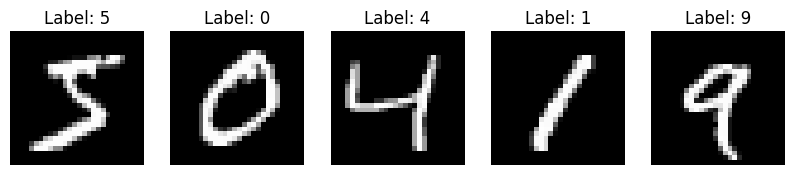

In [4]:
def plot_images(images, labels, num_images=5):
    # Create a figure for displaying images
    plt.figure(figsize=(10, 2))
    
    for i in range(num_images):
        plt.subplot(1, num_images, i + 1)  # Create a subplot for each image
        plt.imshow(images[i], cmap='gray')  # Display the image in grayscale
        plt.title(f'Label: {labels[i]}')  # Set the title as the corresponding label
        plt.axis('off')  # Turn off the axis for a cleaner visualization
    plt.show()  # Show the plot with the selected images and labels
# Example: Plot 5 images and their corresponding labels
plot_images(X_train,Y_train, num_images=5)

In [5]:
print(Y_train_one_hot[:5])

[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]


In [6]:
print(X_train_flat[0])

[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         

In [7]:
class Neural_Network:
    def __init__(self, N, A, lr, Activation_Function, Weight_init, Num_epochs, Batch_size, alpha_for_LeReLu):
        self.N = N  
        self.A = A 
        self.lr = lr  
        self.Activation_Function = Activation_Function  
        self.Weight_init = Weight_init 
        self.Num_epochs = Num_epochs  
        self.Batch_size = Batch_size  
        self.alpha_for_LeReLu=alpha_for_LeReLu
        
        # Additional initialization, like setting weights, could be added here
        print("Neural Network Initialized with parameters:")
        print(f"N: {self.N}, Architecture: {self.A}, Learning Rate: {self.lr}")
        print(f"Activation Function: {self.Activation_Function}, Weight Init: {self.Weight_init}")
        print(f"Epochs: {self.Num_epochs}, Batch Size: {self.Batch_size}")
        self.Weightsnn=[]
        self.biasnn=[]
        for i in range(N):
            tempw,tempb=self.wts_for_init(A[i+1],A[i])
            self.Weightsnn.append(tempw)
            self.biasnn.append(tempb)

    def activation_func(self, z):
        if self.Activation_Function == "sigmoid":
            return 1 / (1 + np.exp(-z))
        elif self.Activation_Function == "ReLu":
            return np.maximum(0, z)
        elif self.Activation_Function == "tanh":
            return np.tanh(z)
        elif self.Activation_Function == "softmax":
            z_stable = z - np.max(z, axis=0, keepdims=True)
            exp_temp = np.exp(z_stable)
            return exp_temp / np.sum(exp_temp, axis=0, keepdims=True)
        elif self.Activation_Function == "LeakyReLu":
            return np.where(z > 0, z, self.alpha_for_LeReLu * z)
        



    def activation_grad(self, z):
        if self.Activation_Function=="sigmoid":
            return self.activation_func(z)*(1-self.activation_func(z))
        elif self.Activation_Function=="ReLu":
            return z>0
        elif self.Activation_Function=="tanh":
            return 1-np.power(self.activation_func(z),2)
        elif self.Activation_Function=="LeakyReLu":
            return np.where(z>0,1,self.alpha_for_LeReLu)
        
        

    def activation_func_out_layer(self, z, Activation_function_last_layer):
        if Activation_function_last_layer == "softmax":
            z_stable = z - np.max(z, axis=0, keepdims=True)
            exp_temp = np.exp(z_stable)
            
            return exp_temp / np.sum(exp_temp, axis=0, keepdims=True)
        elif Activation_function_last_layer == "sigmoid":
            return 1 / (1 + np.exp(z))
        elif Activation_function_last_layer == "ReLu":
            return np.maximum(0, z)
            



    def activation_grad_out_layer(self, z, Activation_function_last_layer):
        if Activation_function_last_layer=="sigmoid":
            return (np.exp(-z))/((np.exp(-z)+1)**2)
        elif Activation_function_last_layer=="ReLu":
            return np.where(z>0,1,0)
        



    def wts_for_init(self, output_dim, input_dim):
        if self.Weight_init=="zero":
            return np.zeros((output_dim,input_dim)),np.zeros((output_dim,1))
        elif self.Weight_init == "random":
            stddev = np.sqrt(2 / input_dim)
            return np.random.rand(output_dim,input_dim)*stddev,np.random.rand(output_dim,1)
        elif self.Weight_init == "normal":
            stddev = np.sqrt(1 / input_dim)
            return np.random.randn(output_dim, input_dim) * stddev, np.random.randn(output_dim, 1) * stddev
    def forward_pass(self, x_in):
        self.Activation_out=[]
        self.Z_out=[]
        x_temp=x_in
        self.Activation_out.append(x_in)
        for i in range(self.N-1):
            z=np.dot(self.Weightsnn[i],x_temp)+self.biasnn[i]
            # print(z)
            self.Z_out.append(z)
            x_temp=self.activation_func(z)
            # print(x_temp)
            self.Activation_out.append(x_temp)
        temp_1=np.dot(self.Weightsnn[-1],x_temp)+self.biasnn[-1]
        self.Z_out.append(temp_1)
        temp_2=self.activation_func_out_layer(temp_1,"softmax")
        self.Activation_out.append(temp_2)
        return self.Activation_out[-1]
    def backward_pass(self,y_pred, y_actual):



        change_w, change_b = [], []
        err = -y_actual + y_pred
        dw_out = (1 / self.Batch_size) * np.dot(err, self.Activation_out[-2].T)
        db_out = (1 / self.Batch_size) * np.sum(err, axis=1, keepdims=True)
        change_w.append(dw_out)
        change_b.append(db_out)

        for i in range(len(self.Weightsnn) - 2, -1, -1):
            err = np.dot(self.Weightsnn[i + 1].T, err)* self.activation_grad(self.Z_out[i])
            dw = (1 / self.Batch_size) * np.dot(err, self.Activation_out[i].T)
            db = (1 / self.Batch_size) * np.sum(err, axis=1, keepdims=True)
            change_w.append(dw)
            change_b.append(db)

        change_w.reverse()
        change_b.reverse()
        return change_w, change_b
    def compute_cost(self, Y_pred, Y_actual):
        m = Y_actual.shape[1]  # Number of samples
        cost = -np.sum(Y_actual * np.log(Y_pred )) / m
        return np.squeeze(cost)
    
    
    def fit(self, X_in, Y_act,X_val,Y_val, patience=10, min_delta=1e-6):
        num_samples = X_in.shape[1]
        num_batches = num_samples // self.Batch_size
        if num_samples % self.Batch_size != 0:
            num_batches += 1
        costs = []
        costs_val=[]

        # Split into training and validation sets
        X_train=X_in
        Y_train=Y_act
        train_samples = X_train.shape[1]
        
        best_val_cost = float('inf')
        patience_counter = 0

        for epoch in range(self.Num_epochs):
            # Shuffle training data
            indices = np.random.permutation(train_samples)
            X_train_shuffled = X_train[:, indices]
            Y_train_shuffled = Y_train[:, indices]
            
            for j in range(num_batches):
                start_ind = j * self.Batch_size
                end_ind = min(train_samples, (j + 1) * self.Batch_size)
                
                # Get the batch of data
                X_batch = X_train_shuffled[:, start_ind:end_ind]
                Y_batch = Y_train_shuffled[:, start_ind:end_ind]
                
                # Perform forward and backward pass
                out_put = self.forward_pass(X_batch)
                changes_w, changes_b = self.backward_pass(out_put, Y_batch)
                for k in range(len(changes_w)):
                    self.Weightsnn[k] -= self.lr * changes_w[k]
                    self.biasnn[k] -= self.lr * changes_b[k]
            
            # Calculate training cost
            Y_pred_train = self.forward_pass(X_train)
            train_cost = self.compute_cost(Y_pred_train, Y_train)
            costs.append(train_cost)

            Y_pred_val=self.forward_pass(X_val)
            val_cost=self.compute_cost(Y_pred_val,Y_val)
            costs_val.append(val_cost)

            # Calculate validation cost
            Y_pred_val = self.forward_pass(X_val)
            val_cost = self.compute_cost(Y_pred_val, Y_val)

            print(f"Epoch {epoch + 1}, Training Cost: {train_cost:.4f}, Validation Cost: {val_cost:.4f}")

            # Early stopping check
            if val_cost < best_val_cost - min_delta:
                best_val_cost = val_cost
                patience_counter = 0  # Reset patience counter if improvement is seen
            else:
                patience_counter += 1

            if patience_counter >= patience:
                print(f"Early stopping at epoch {epoch + 1}")
                break

        return costs,costs_val
    
    def compute_cost(self, Y_pred, Y_actual):
        """
        Calculate cross-entropy cost.
        """
        m = Y_actual.shape[1] 
        epsilon = 1e-10 
        cost = -np.sum(Y_actual * np.log(Y_pred + epsilon)) / m
        return np.squeeze(cost)
    
    
   
    def predict(self, X_in):
        Y_proba = self.forward_pass(X_in)
        with np.printoptions(threshold=np.inf):
            print(Y_proba)
        return np.argmax(Y_proba, axis=0)
    def predict_proba(self, X_in):
        Y_prob=self.forward_pass(X_in)
        return Y_prob.T

    def score(self, X_in, Y_act):
        predictions = self.predict(X_in)
        accuracy = np.mean(predictions == Y_act)
        return accuracy

In [8]:
X_train=idx2numpy.convert_from_file(train_images_path)
Y_train=idx2numpy.convert_from_file(train_labels_path)

print(X_train.shape)    

X_train_flat = X_train.reshape(X_train.shape[0] , -1)/255; 

print(X_train_flat.shape) ;  



Y_train_one_hot = np.eye(10)[Y_train] ; 
print(Y_train_one_hot.shape)
X_train_split, X_rem_split, Y_train_split, Y_rem_split = train_test_split(X_train_flat, Y_train_one_hot, test_size=0.2, random_state=42)


X_val_split, X_test_split, Y_val_split, Y_test_split = train_test_split(X_rem_split, Y_rem_split, test_size=0.5, random_state=42)

(60000, 28, 28)
(60000, 784)
(60000, 10)


In [9]:
print(np.where(Y_train_one_hot==1)[1])
print("****************")
print(Y_train)


[5 0 4 ... 5 6 8]
****************
[5 0 4 ... 5 6 8]


In [10]:
# def plot_images(images, num_images=5):
#     # Create a figure for displaying images
#     plt.figure(figsize=(10, 2))
    
#     for i in range(num_images):
#         plt.subplot(1, num_images, i + 1)  # Create a subplot for each image
#         plt.imshow(images[i], cmap='gray')  # Display the image in grayscale
#         # plt.title(f'Label: {labels[i]}')  # Set the title as the corresponding label
#         # plt.axis('off')  # Turn off the axis for a cleaner visualization
#     plt.show()  # Show the plot with the selected images and labels
# # Example: Plot 5 images and their corresponding labels
# plot_images(X_test_split, num_images=5)

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: sigmoid, Weight Init: zero
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3015, Validation Cost: 2.3014
Epoch 2, Training Cost: 2.3012, Validation Cost: 2.3011
Epoch 3, Training Cost: 2.3011, Validation Cost: 2.3011
Epoch 4, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 5, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 6, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 7, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 8, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 9, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 10, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 11, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 12, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 13, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 14, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 15, Training C

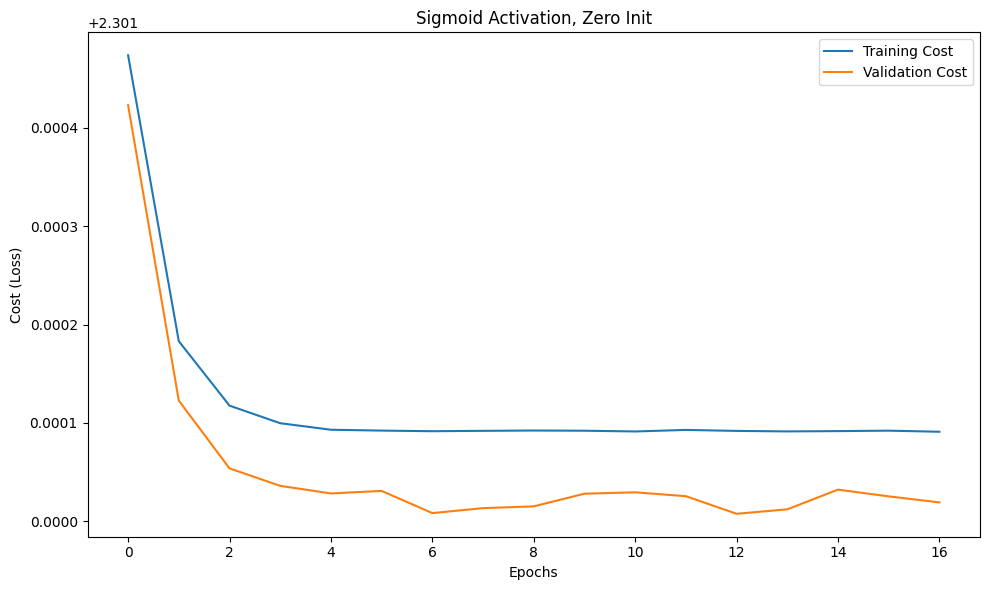

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: sigmoid, Weight Init: random
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3024, Validation Cost: 2.3024
Epoch 2, Training Cost: 2.3011, Validation Cost: 2.3011
Epoch 3, Training Cost: 2.3011, Validation Cost: 2.3012
Epoch 4, Training Cost: 2.3012, Validation Cost: 2.3012
Epoch 5, Training Cost: 2.3012, Validation Cost: 2.3011
Epoch 6, Training Cost: 2.3011, Validation Cost: 2.3011
Epoch 7, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 8, Training Cost: 2.3011, Validation Cost: 2.3009
Epoch 9, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 10, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 11, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 12, Training Cost: 2.3012, Validation Cost: 2.3010
Epoch 13, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 14, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 15, Training

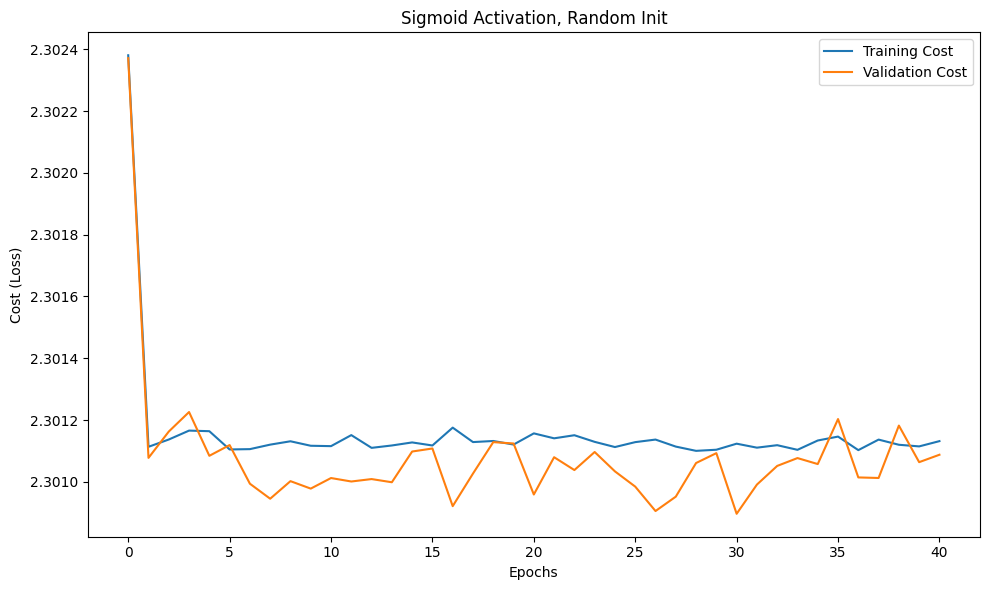

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: sigmoid, Weight Init: normal
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3431, Validation Cost: 2.3428
Epoch 2, Training Cost: 2.3115, Validation Cost: 2.3113
Epoch 3, Training Cost: 2.3036, Validation Cost: 2.3035
Epoch 4, Training Cost: 2.3016, Validation Cost: 2.3015
Epoch 5, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 6, Training Cost: 2.3010, Validation Cost: 2.3008
Epoch 7, Training Cost: 2.3009, Validation Cost: 2.3008
Epoch 8, Training Cost: 2.3009, Validation Cost: 2.3008
Epoch 9, Training Cost: 2.3009, Validation Cost: 2.3008
Epoch 10, Training Cost: 2.3009, Validation Cost: 2.3008
Epoch 11, Training Cost: 2.3008, Validation Cost: 2.3008
Epoch 12, Training Cost: 2.3008, Validation Cost: 2.3008
Epoch 13, Training Cost: 2.3008, Validation Cost: 2.3008
Epoch 14, Training Cost: 2.3008, Validation Cost: 2.3007
Epoch 15, Training

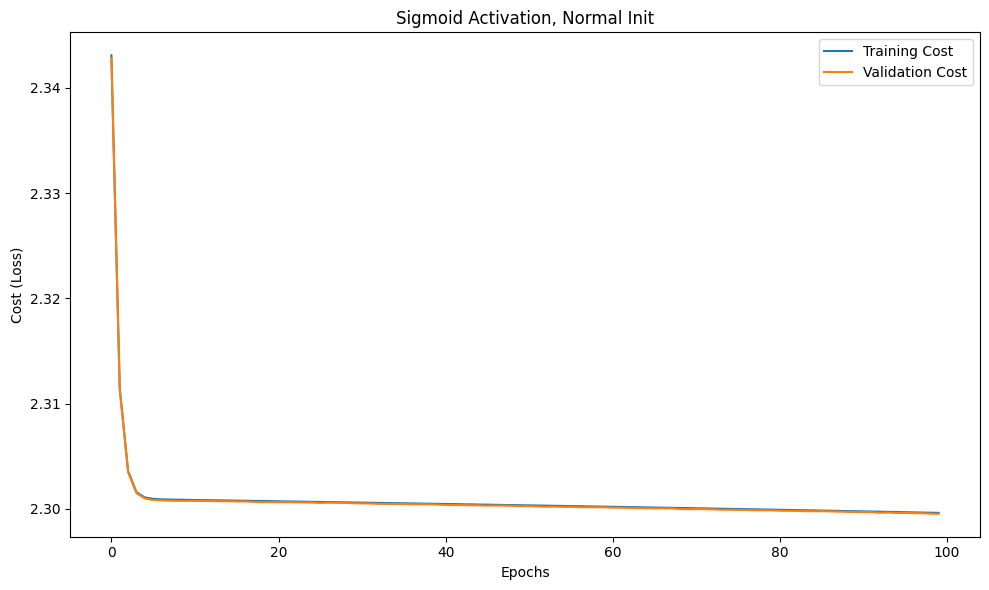

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: ReLu, Weight Init: zero
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3024, Validation Cost: 2.3024
Epoch 2, Training Cost: 2.3022, Validation Cost: 2.3022
Epoch 3, Training Cost: 2.3020, Validation Cost: 2.3020
Epoch 4, Training Cost: 2.3019, Validation Cost: 2.3019
Epoch 5, Training Cost: 2.3018, Validation Cost: 2.3018
Epoch 6, Training Cost: 2.3017, Validation Cost: 2.3017
Epoch 7, Training Cost: 2.3016, Validation Cost: 2.3016
Epoch 8, Training Cost: 2.3015, Validation Cost: 2.3015
Epoch 9, Training Cost: 2.3015, Validation Cost: 2.3014
Epoch 10, Training Cost: 2.3014, Validation Cost: 2.3014
Epoch 11, Training Cost: 2.3014, Validation Cost: 2.3013
Epoch 12, Training Cost: 2.3013, Validation Cost: 2.3013
Epoch 13, Training Cost: 2.3013, Validation Cost: 2.3012
Epoch 14, Training Cost: 2.3013, Validation Cost: 2.3012
Epoch 15, Training Cost

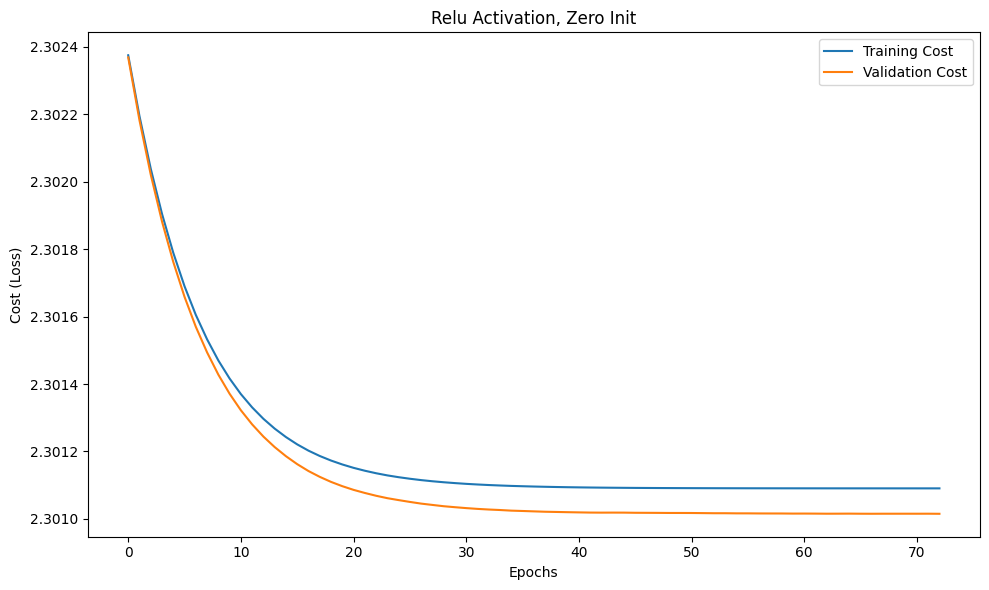

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: ReLu, Weight Init: random
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3255, Validation Cost: 2.3252
Epoch 2, Training Cost: 2.3220, Validation Cost: 2.3218
Epoch 3, Training Cost: 2.3191, Validation Cost: 2.3189
Epoch 4, Training Cost: 2.3166, Validation Cost: 2.3164
Epoch 5, Training Cost: 2.3145, Validation Cost: 2.3143
Epoch 6, Training Cost: 2.3126, Validation Cost: 2.3124
Epoch 7, Training Cost: 2.3110, Validation Cost: 2.3108
Epoch 8, Training Cost: 2.3096, Validation Cost: 2.3095
Epoch 9, Training Cost: 2.3085, Validation Cost: 2.3083
Epoch 10, Training Cost: 2.3075, Validation Cost: 2.3073
Epoch 11, Training Cost: 2.3066, Validation Cost: 2.3064
Epoch 12, Training Cost: 2.3058, Validation Cost: 2.3057
Epoch 13, Training Cost: 2.3052, Validation Cost: 2.3050
Epoch 14, Training Cost: 2.3046, Validation Cost: 2.3045
Epoch 15, Training Co

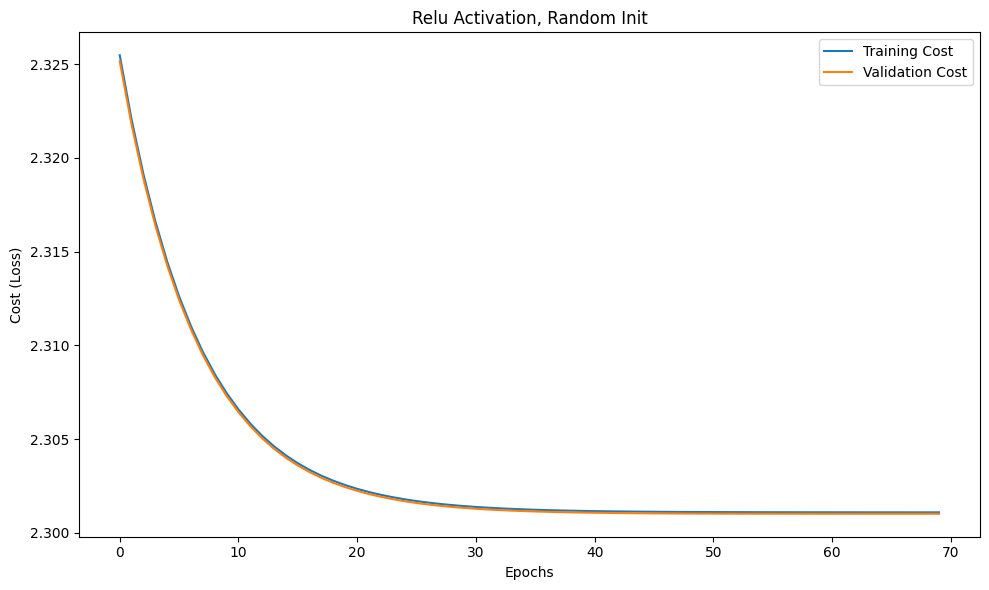

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: ReLu, Weight Init: normal
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.2842, Validation Cost: 2.2838
Epoch 2, Training Cost: 2.2219, Validation Cost: 2.2211
Epoch 3, Training Cost: 2.1253, Validation Cost: 2.1240
Epoch 4, Training Cost: 1.9511, Validation Cost: 1.9494
Epoch 5, Training Cost: 1.6703, Validation Cost: 1.6696
Epoch 6, Training Cost: 1.3194, Validation Cost: 1.3213
Epoch 7, Training Cost: 1.0240, Validation Cost: 1.0278
Epoch 8, Training Cost: 0.8244, Validation Cost: 0.8278
Epoch 9, Training Cost: 0.6952, Validation Cost: 0.6978
Epoch 10, Training Cost: 0.6106, Validation Cost: 0.6123
Epoch 11, Training Cost: 0.5516, Validation Cost: 0.5522
Epoch 12, Training Cost: 0.5088, Validation Cost: 0.5086
Epoch 13, Training Cost: 0.4748, Validation Cost: 0.4740
Epoch 14, Training Cost: 0.4474, Validation Cost: 0.4461
Epoch 15, Training Co

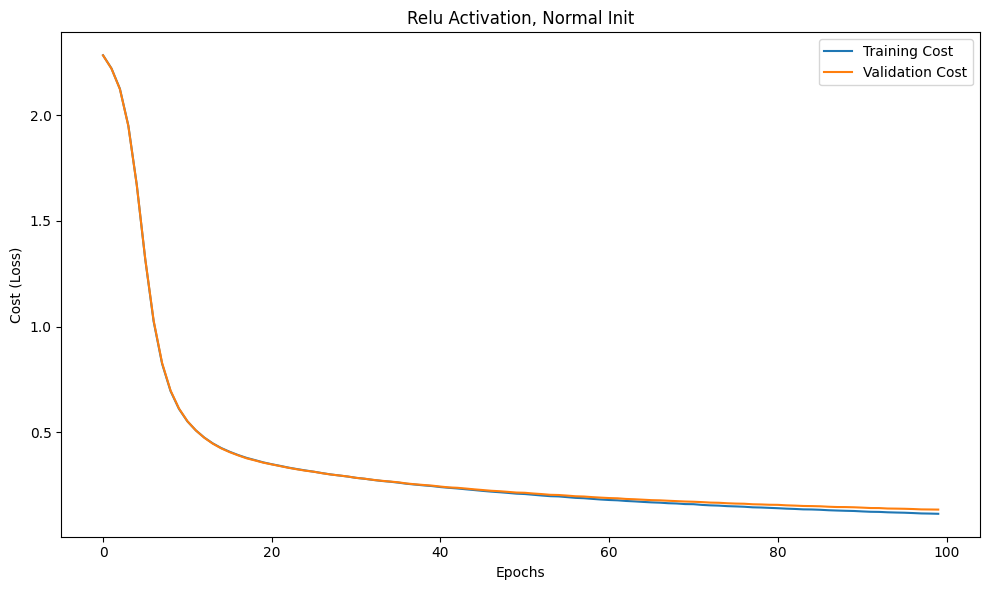

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: tanh, Weight Init: zero
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3024, Validation Cost: 2.3024
Epoch 2, Training Cost: 2.3022, Validation Cost: 2.3022
Epoch 3, Training Cost: 2.3020, Validation Cost: 2.3020
Epoch 4, Training Cost: 2.3019, Validation Cost: 2.3019
Epoch 5, Training Cost: 2.3018, Validation Cost: 2.3018
Epoch 6, Training Cost: 2.3017, Validation Cost: 2.3017
Epoch 7, Training Cost: 2.3016, Validation Cost: 2.3016
Epoch 8, Training Cost: 2.3015, Validation Cost: 2.3015
Epoch 9, Training Cost: 2.3015, Validation Cost: 2.3014
Epoch 10, Training Cost: 2.3014, Validation Cost: 2.3014
Epoch 11, Training Cost: 2.3014, Validation Cost: 2.3013
Epoch 12, Training Cost: 2.3013, Validation Cost: 2.3013
Epoch 13, Training Cost: 2.3013, Validation Cost: 2.3012
Epoch 14, Training Cost: 2.3013, Validation Cost: 2.3012
Epoch 15, Training Cost

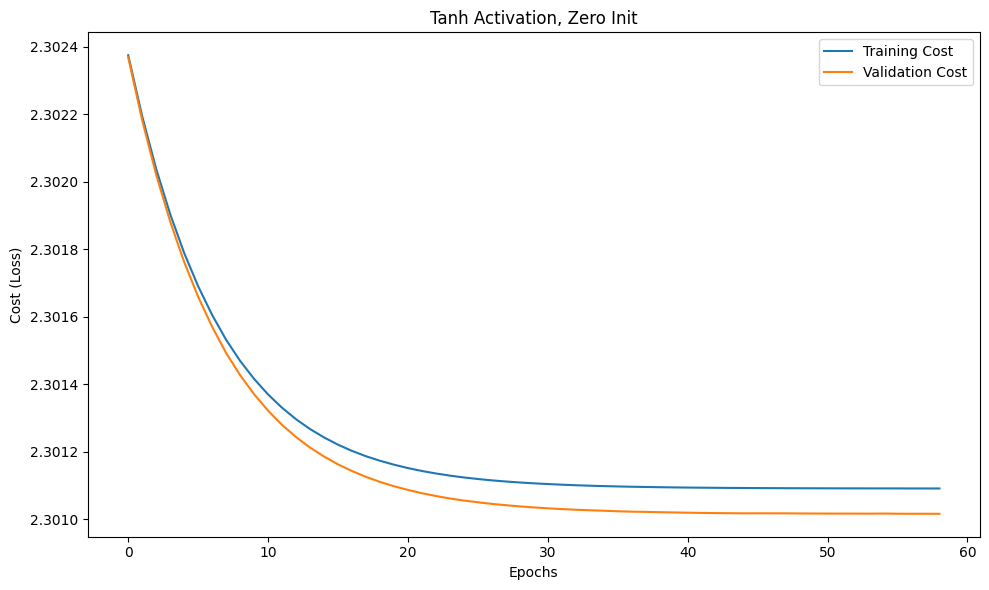

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: tanh, Weight Init: random
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3016, Validation Cost: 2.3009
Epoch 2, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 3, Training Cost: 2.3011, Validation Cost: 2.3009
Epoch 4, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 5, Training Cost: 2.3011, Validation Cost: 2.3011
Epoch 6, Training Cost: 2.3011, Validation Cost: 2.3011
Epoch 7, Training Cost: 2.3011, Validation Cost: 2.3012
Epoch 8, Training Cost: 2.3011, Validation Cost: 2.3011
Epoch 9, Training Cost: 2.3011, Validation Cost: 2.3010
Epoch 10, Training Cost: 2.3011, Validation Cost: 2.3012
Epoch 11, Training Cost: 2.3012, Validation Cost: 2.3011
Epoch 12, Training Cost: 2.3011, Validation Cost: 2.3011
Epoch 13, Training Cost: 2.3011, Validation Cost: 2.3010
Early stopping at epoch 13
Model saved as ./Saved_models_Section-B/model_tanh_

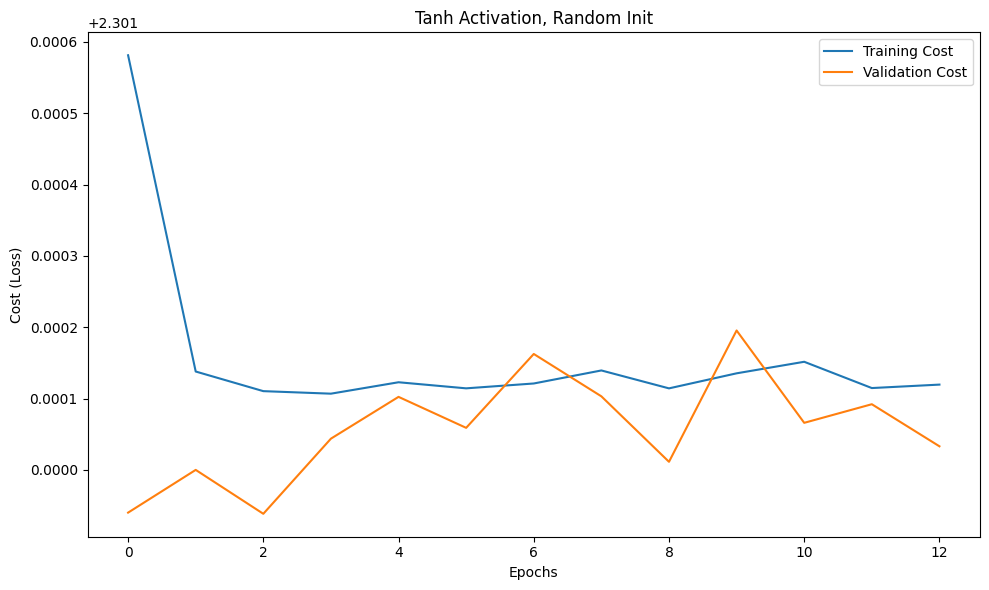

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: tanh, Weight Init: normal
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 1.6965, Validation Cost: 1.6965
Epoch 2, Training Cost: 1.3548, Validation Cost: 1.3547
Epoch 3, Training Cost: 1.1426, Validation Cost: 1.1423
Epoch 4, Training Cost: 0.9943, Validation Cost: 0.9938
Epoch 5, Training Cost: 0.8832, Validation Cost: 0.8827
Epoch 6, Training Cost: 0.7966, Validation Cost: 0.7959
Epoch 7, Training Cost: 0.7272, Validation Cost: 0.7265
Epoch 8, Training Cost: 0.6706, Validation Cost: 0.6699
Epoch 9, Training Cost: 0.6239, Validation Cost: 0.6230
Epoch 10, Training Cost: 0.5848, Validation Cost: 0.5839
Epoch 11, Training Cost: 0.5520, Validation Cost: 0.5510
Epoch 12, Training Cost: 0.5242, Validation Cost: 0.5230
Epoch 13, Training Cost: 0.5004, Validation Cost: 0.4989
Epoch 14, Training Cost: 0.4797, Validation Cost: 0.4780
Epoch 15, Training Co

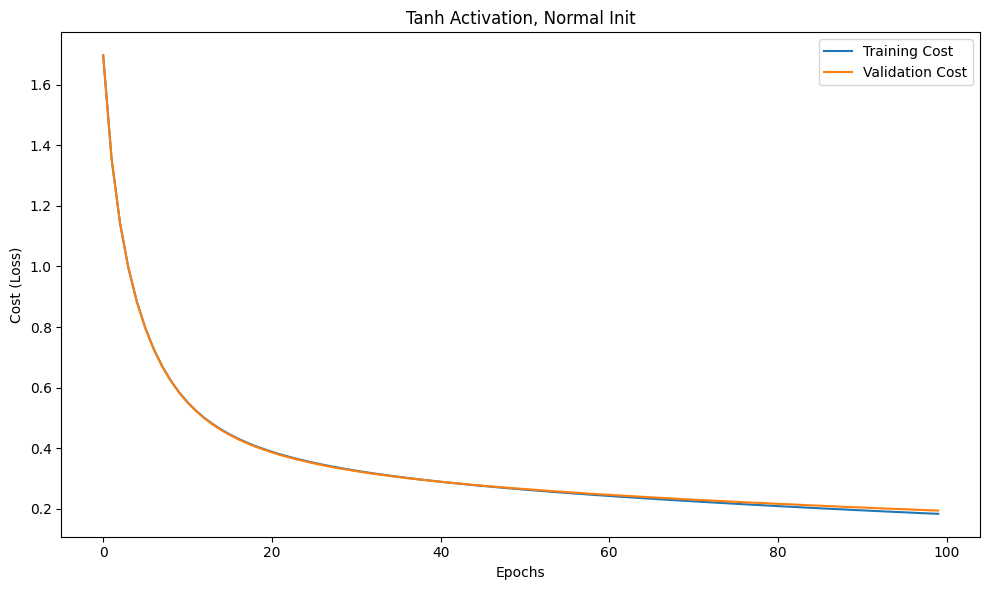

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: LeakyReLu, Weight Init: zero
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3024, Validation Cost: 2.3024
Epoch 2, Training Cost: 2.3022, Validation Cost: 2.3022
Epoch 3, Training Cost: 2.3020, Validation Cost: 2.3020
Epoch 4, Training Cost: 2.3019, Validation Cost: 2.3019
Epoch 5, Training Cost: 2.3018, Validation Cost: 2.3018
Epoch 6, Training Cost: 2.3017, Validation Cost: 2.3017
Epoch 7, Training Cost: 2.3016, Validation Cost: 2.3016
Epoch 8, Training Cost: 2.3015, Validation Cost: 2.3015
Epoch 9, Training Cost: 2.3015, Validation Cost: 2.3014
Epoch 10, Training Cost: 2.3014, Validation Cost: 2.3014
Epoch 11, Training Cost: 2.3014, Validation Cost: 2.3013
Epoch 12, Training Cost: 2.3013, Validation Cost: 2.3013
Epoch 13, Training Cost: 2.3013, Validation Cost: 2.3012
Epoch 14, Training Cost: 2.3013, Validation Cost: 2.3012
Epoch 15, Training

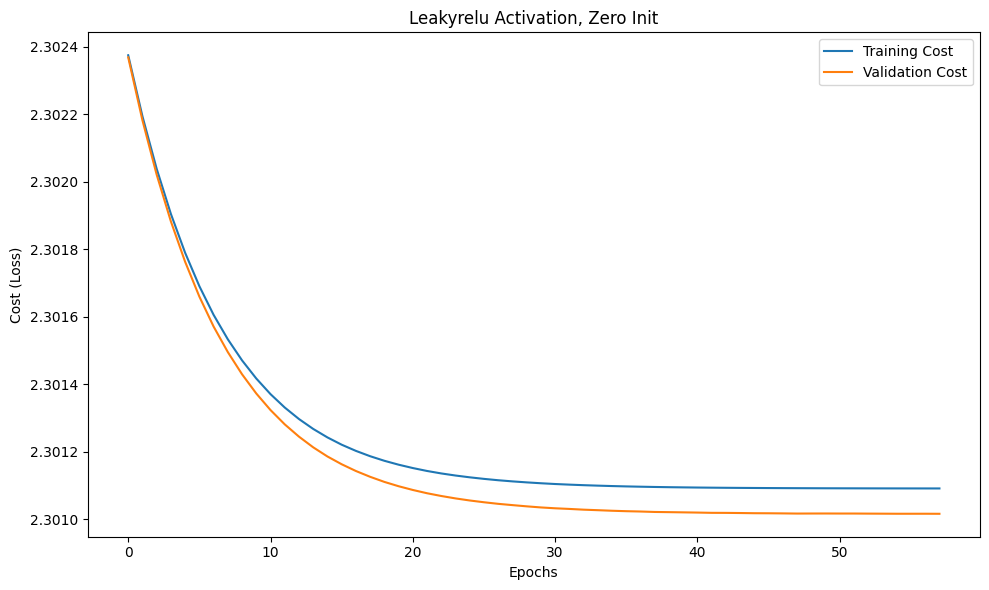

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: LeakyReLu, Weight Init: random
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3380, Validation Cost: 2.3409
Epoch 2, Training Cost: 2.2845, Validation Cost: 2.2852
Epoch 3, Training Cost: 2.2270, Validation Cost: 2.2279
Epoch 4, Training Cost: 2.1704, Validation Cost: 2.1730
Epoch 5, Training Cost: 2.1418, Validation Cost: 2.1459
Epoch 6, Training Cost: 2.1190, Validation Cost: 2.1243
Epoch 7, Training Cost: 2.0996, Validation Cost: 2.1054
Epoch 8, Training Cost: 2.0841, Validation Cost: 2.0903
Epoch 9, Training Cost: 2.0630, Validation Cost: 2.0697
Epoch 10, Training Cost: 2.0482, Validation Cost: 2.0550
Epoch 11, Training Cost: 2.0310, Validation Cost: 2.0388
Epoch 12, Training Cost: 2.0189, Validation Cost: 2.0264
Epoch 13, Training Cost: 2.0040, Validation Cost: 2.0123
Epoch 14, Training Cost: 1.9909, Validation Cost: 1.9992
Epoch 15, Traini

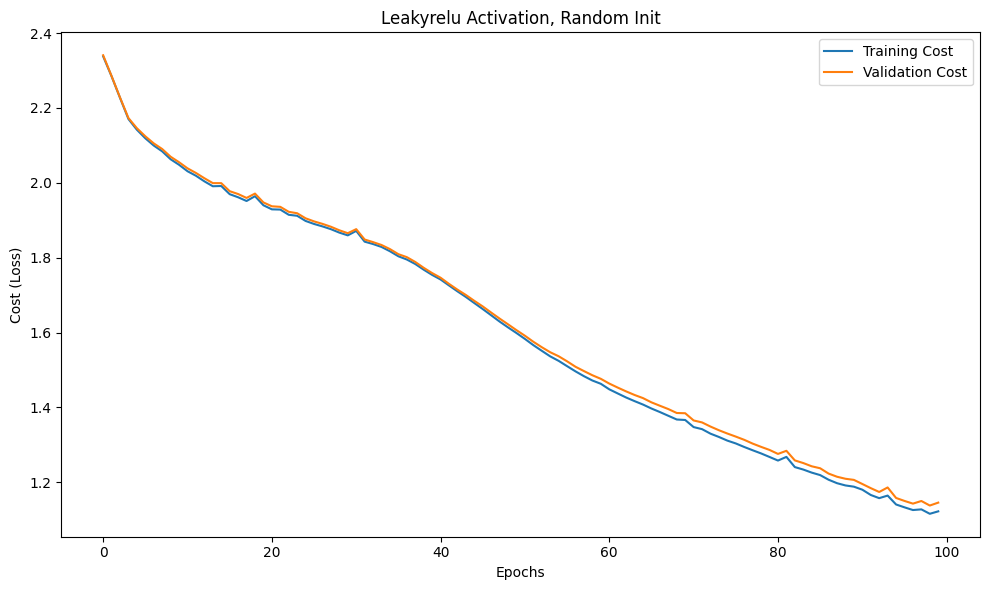

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.002
Activation Function: LeakyReLu, Weight Init: normal
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.2796, Validation Cost: 2.2819
Epoch 2, Training Cost: 2.2217, Validation Cost: 2.2240
Epoch 3, Training Cost: 2.1312, Validation Cost: 2.1337
Epoch 4, Training Cost: 1.9781, Validation Cost: 1.9815
Epoch 5, Training Cost: 1.7383, Validation Cost: 1.7423
Epoch 6, Training Cost: 1.4357, Validation Cost: 1.4389
Epoch 7, Training Cost: 1.1617, Validation Cost: 1.1631
Epoch 8, Training Cost: 0.9495, Validation Cost: 0.9484
Epoch 9, Training Cost: 0.7968, Validation Cost: 0.7933
Epoch 10, Training Cost: 0.6881, Validation Cost: 0.6827
Epoch 11, Training Cost: 0.6113, Validation Cost: 0.6055
Epoch 12, Training Cost: 0.5555, Validation Cost: 0.5499
Epoch 13, Training Cost: 0.5143, Validation Cost: 0.5093
Epoch 14, Training Cost: 0.4832, Validation Cost: 0.4782
Epoch 15, Traini

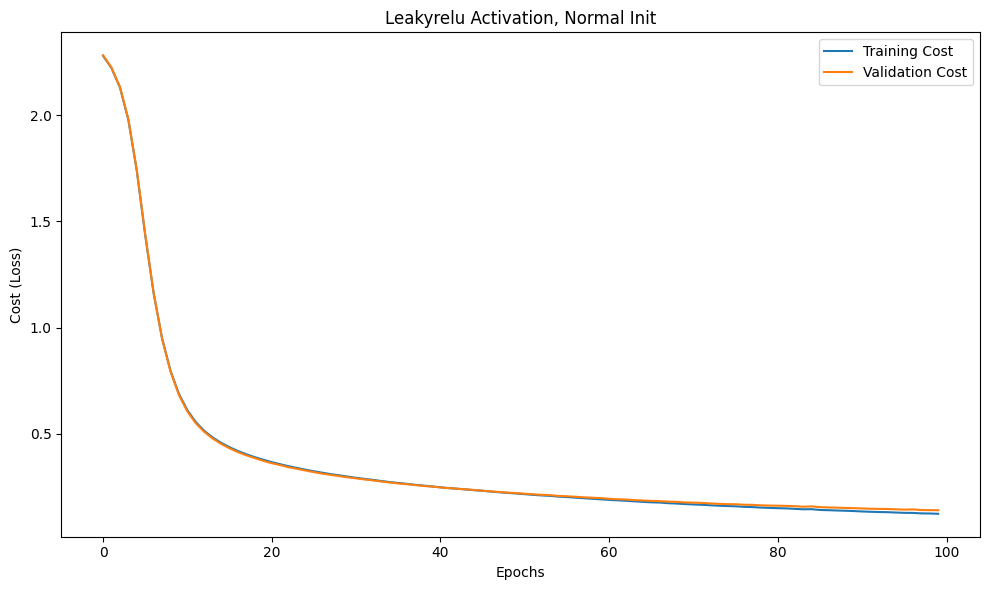

In [12]:
import pickle
import matplotlib.pyplot as plt

# Parameters
N = 5  # Number of layers
A = [784, 256, 128, 64, 32, 10]  # Architecture: Input layer with 784, hidden layers, and output with 10 classes
lr = 2e-3  # Learning rate
num_epochs = 100  # Number of epochs
batch_size = 128  # Batch size

# Variations
activation_functions = ["sigmoid", "ReLu", "tanh", "LeakyReLu"]
weight_inits = ["zero", "random", "normal"]
alpha_for_LeReLu = 0.01

# Dictionary to store all costs
all_costs = {}

# Loop over each activation function and weight initialization method
for activation_function in activation_functions:
    for init_method in weight_inits:
        # Initialize the neural network with specified parameters
        nn = Neural_Network(N, A, lr, Activation_Function=activation_function, 
                            Weight_init=init_method, Num_epochs=num_epochs, 
                            Batch_size=batch_size, alpha_for_LeReLu=alpha_for_LeReLu)
        
        # Train the neural network and get the costs
        train_costs, val_costs = nn.fit(X_train_split.T, Y_train_split.T,X_val_split.T,Y_val_split.T)  # Assume fit returns (train_costs, val_costs)
        all_costs[(activation_function, init_method)] = (train_costs, val_costs)

        # Save the model
        model_file_name = f"./Saved_models_Section-B/model_{activation_function}_{init_method}.pkl"
        with open(model_file_name, 'wb') as file:
            pickle.dump(nn, file)
        print(f"Model saved as {model_file_name}")

        # Get final test accuracy
        final_accuracy = nn.score(X_test_split.T, np.where(Y_test_split == 1)[1])  # Assuming Y_test_split has one-hot labels
        print(f"Final accuracy for {activation_function.capitalize()} Activation with {init_method.capitalize()} Init: {final_accuracy * 100:.2f}%")

        # Plot the training and validation cost curves
        plt.figure(figsize=(10, 6))
        plt.plot(train_costs, label=f"Training Cost")
        plt.plot(val_costs, label=f"Validation Cost")
        plt.xlabel('Epochs')
        plt.ylabel('Cost (Loss)')
        plt.title(f'{activation_function.capitalize()} Activation, {init_method.capitalize()} Init')
        plt.legend()
        plt.tight_layout()
        plt.show()


Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.001
Activation Function: ReLu, Weight Init: normal
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3227, Validation Cost: 2.3231
Epoch 2, Training Cost: 2.2970, Validation Cost: 2.2982
Epoch 3, Training Cost: 2.2694, Validation Cost: 2.2712
Epoch 4, Training Cost: 2.2386, Validation Cost: 2.2409
Epoch 5, Training Cost: 2.2001, Validation Cost: 2.2026
Epoch 6, Training Cost: 2.1507, Validation Cost: 2.1535
Epoch 7, Training Cost: 2.0870, Validation Cost: 2.0901
Epoch 8, Training Cost: 2.0066, Validation Cost: 2.0100
Epoch 9, Training Cost: 1.9065, Validation Cost: 1.9098
Epoch 10, Training Cost: 1.7847, Validation Cost: 1.7878
Epoch 11, Training Cost: 1.6459, Validation Cost: 1.6489
Epoch 12, Training Cost: 1.4986, Validation Cost: 1.5020
Epoch 13, Training Cost: 1.3512, Validation Cost: 1.3560
Epoch 14, Training Cost: 1.2123, Validation Cost: 1.2193
Epoch 15, Training Co

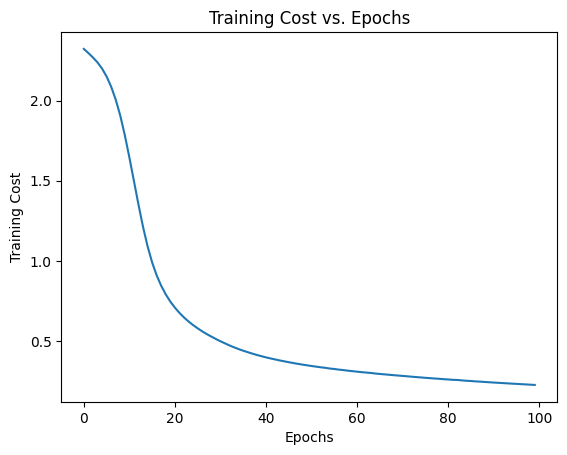

In [ ]:
network = Neural_Network(
    N=5, 
    A=[784,256, 128, 64, 32, 10] , 
    lr=0.001, 
    Activation_Function="ReLu", 
    Weight_init="normal", 
    Num_epochs=100, 
    Batch_size=128, 
    alpha_for_LeReLu=0.01
)
costs = network.fit(X_train_split.T, Y_train_split.T)

# Plot training cost
plt.plot(costs)
plt.xlabel("Epochs")
plt.ylabel("Training Cost")
plt.title("Training Cost vs. Epochs")
plt.show()

# Final accuracy
# test_accuracy = network.score(X_train_flat.T, Y_train)
# print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


In [ ]:
# print(np.where(Y_test_split==1)[1])
test_accuracy = network.score(X_test_split.T, np.where(Y_test_split==1)[1])
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


[[3.48534945e-05 6.63904413e-03 1.48343277e-05 8.57459567e-06
  4.21139074e-06 1.10999882e-04 9.99789068e-01 6.35740010e-05
  1.47882642e-05 8.57784119e-03 5.93460765e-04 1.70765966e-04
  6.25667302e-08 4.42166404e-08 1.11853751e-05 1.57422063e-06
  4.25162587e-06 9.98453034e-01 1.97030779e-06 9.77535950e-08
  5.84955929e-10 3.52707439e-06 9.99139036e-01 2.31818473e-06
  1.86164248e-08 3.15712359e-06 4.50329668e-06 3.14827354e-04
  5.20949998e-04 5.34040504e-06 2.06697298e-04 2.48149369e-06
  1.00601920e-03 9.95913387e-05 7.28090637e-03 3.80034201e-04
  5.01528706e-05 7.12251983e-05 4.75126574e-07 9.49192200e-08
  1.64317028e-05 6.85672615e-06 1.23867055e-04 1.02077796e-03
  1.94923851e-04 1.89375926e-03 5.55001502e-02 2.21267121e-09
  4.25248337e-07 5.65126181e-08 1.73704507e-04 2.65638623e-05
  4.61181790e-03 9.04545931e-01 4.95128105e-03 7.76670008e-04
  2.12669366e-03 3.30071259e-06 4.31479057e-08 1.94829243e-08
  1.93693024e-05 1.53991853e-05 4.82021479e-06 4.59167617e-07
  4.8762

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 0.001
Activation Function: sigmoid, Weight Init: random
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3125, Validation Cost: 2.3110
Epoch 2, Training Cost: 2.3023, Validation Cost: 2.3022
Epoch 3, Training Cost: 2.3012, Validation Cost: 2.3016
Epoch 4, Training Cost: 2.3011, Validation Cost: 2.3016
Epoch 5, Training Cost: 2.3010, Validation Cost: 2.3016
Epoch 6, Training Cost: 2.3010, Validation Cost: 2.3016
Epoch 7, Training Cost: 2.3010, Validation Cost: 2.3017
Epoch 8, Training Cost: 2.3010, Validation Cost: 2.3017
Epoch 9, Training Cost: 2.3010, Validation Cost: 2.3017
Epoch 10, Training Cost: 2.3010, Validation Cost: 2.3017
Epoch 11, Training Cost: 2.3010, Validation Cost: 2.3017
Epoch 12, Training Cost: 2.3010, Validation Cost: 2.3017
Epoch 13, Training Cost: 2.3010, Validation Cost: 2.3017
Epoch 14, Training Cost: 2.3010, Validation Cost: 2.3017
Epoch 15, Training

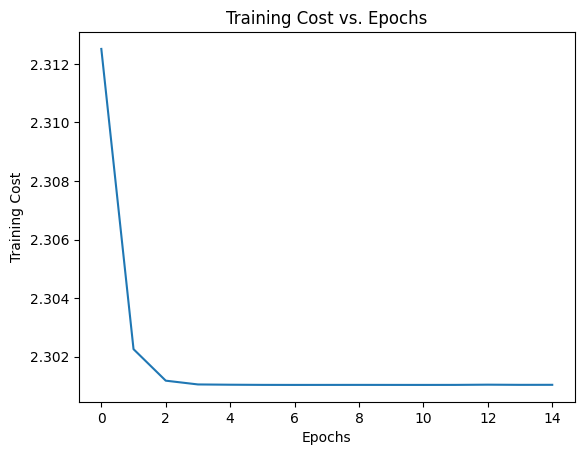

In [ ]:
network = Neural_Network(
    N=5, 
    A=[784,256, 128, 64, 32, 10] , 
    lr=0.001, 
    Activation_Function="sigmoid", 
    Weight_init="random", 
    Num_epochs=100, 
    Batch_size=128, 
    alpha_for_LeReLu=0.01
)
costs = network.fit(X_train_split.T, Y_train_split.T)

# Plot training cost
plt.plot(costs)
plt.xlabel("Epochs")
plt.ylabel("Training Cost")
plt.title("Training Cost vs. Epochs")
plt.show()

# Final accuracy
# test_accuracy = network.score(X_train_flat.T, Y_train)
# print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


In [ ]:
test_accuracy = network.score(X_test_split.T, np.where(Y_test_split==1)[1])
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

[[0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.09858008 0.09858008
  0.09858008 0.09858008 0.09858008 0.09858008 0.

In [ ]:
# nn = Neural_Network(
#     N=5, A=[784,256, 128, 64, 32, 10], lr=2e-3,
#     Activation_Function='ReLu', Weight_init='normal',
#     Num_epochs=50, Batch_size=128, alpha_for_LeReLu=0.01
# )

# costs =nn.fit(X_train_flat.T, Y_train_one_hot.T)
# import matplotlib.pyplot as plt

# plt.plot(costs)
# plt.xlabel('Epochs')
# plt.ylabel('Training Cost')
# plt.title('Training Cost over Epochs')
# plt.show()


In [ ]:
# N = 5  # Number of layers (input layer + 4 hidden layers + output layer)
# A = [784,256,128,64,32, 10]  # Architecture: input size 784 (for 28x28 images), hidden layers, output 10 classes
# lr = 2e-3  # Learning rate
# Activation_Function ="LeakyReLu"  # Activation function for hidden layers
# Weight_init = "zero"  # Weight initialization
# Num_epochs = 100  # Number of epochs
# Batch_size = 128  # Batch size
# alpha_for_LeReLu = 0.01  # Alpha for Leaky ReLU (used if Activation_Function is "LeakyReLu")
# nn_model = Neural_Network(N, A, lr, Activation_Function, Weight_init, Num_epochs, Batch_size, alpha_for_LeReLu)
# cost= nn_model.fit(X_train_flat.T,Y_train_one_hot.T)
# plt.figure(figsize=(12, 8))
# plt.plot(cost, label="ReLu Activation")
# plt.xlabel('Epochs')
# plt.ylabel('Cost (Loss)')
# plt.title('Cost vs. Epoch for Different Activation Functions')
# plt.legend()
# plt.show()

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 2e-05
Activation Function: sigmoid, Weight Init: zero
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3026, Validation Cost: 2.3026
Epoch 2, Training Cost: 2.3025, Validation Cost: 2.3025
Epoch 3, Training Cost: 2.3025, Validation Cost: 2.3025
Epoch 4, Training Cost: 2.3025, Validation Cost: 2.3025
Epoch 5, Training Cost: 2.3025, Validation Cost: 2.3025
Epoch 6, Training Cost: 2.3025, Validation Cost: 2.3024
Epoch 7, Training Cost: 2.3024, Validation Cost: 2.3024
Epoch 8, Training Cost: 2.3024, Validation Cost: 2.3024
Epoch 9, Training Cost: 2.3024, Validation Cost: 2.3024
Epoch 10, Training Cost: 2.3024, Validation Cost: 2.3024
Epoch 11, Training Cost: 2.3024, Validation Cost: 2.3023
Epoch 12, Training Cost: 2.3024, Validation Cost: 2.3023
Epoch 13, Training Cost: 2.3023, Validation Cost: 2.3023
Epoch 14, Training Cost: 2.3023, Validation Cost: 2.3023
Epoch 15, Training C

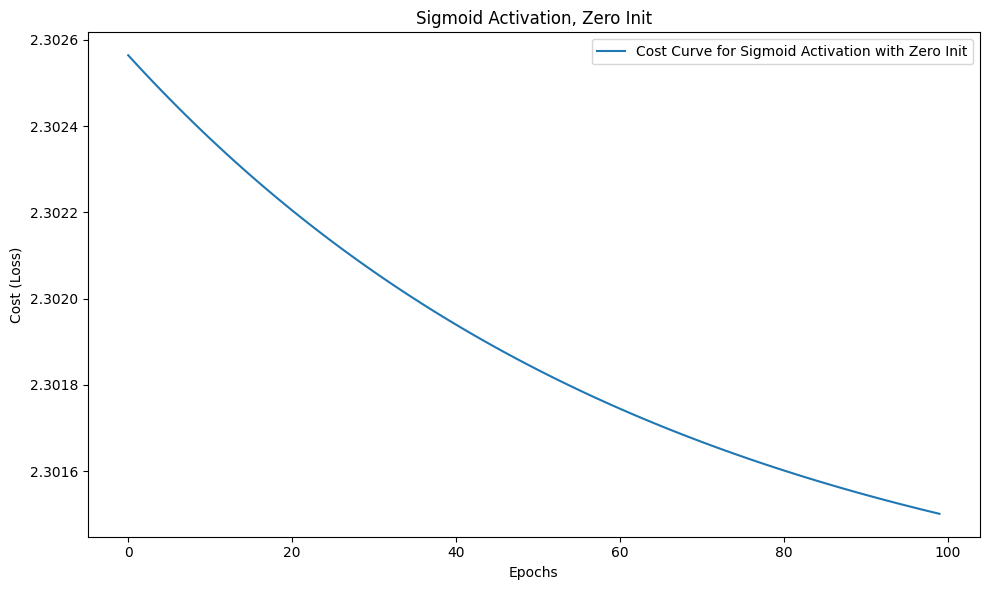

Neural Network Initialized with parameters:
N: 5, Architecture: [784, 256, 128, 64, 32, 10], Learning Rate: 2e-05
Activation Function: sigmoid, Weight Init: random
Epochs: 100, Batch Size: 128
Epoch 1, Training Cost: 2.3809, Validation Cost: 2.3910
Epoch 2, Training Cost: 2.3760, Validation Cost: 2.3858
Epoch 3, Training Cost: 2.3715, Validation Cost: 2.3810
Epoch 4, Training Cost: 2.3672, Validation Cost: 2.3764
Epoch 5, Training Cost: 2.3633, Validation Cost: 2.3722
Epoch 6, Training Cost: 2.3595, Validation Cost: 2.3682
Epoch 7, Training Cost: 2.3561, Validation Cost: 2.3644
Epoch 8, Training Cost: 2.3528, Validation Cost: 2.3609
Epoch 9, Training Cost: 2.3497, Validation Cost: 2.3576
Epoch 10, Training Cost: 2.3469, Validation Cost: 2.3545
Epoch 11, Training Cost: 2.3442, Validation Cost: 2.3516
Epoch 12, Training Cost: 2.3417, Validation Cost: 2.3488
Epoch 13, Training Cost: 2.3393, Validation Cost: 2.3462
Epoch 14, Training Cost: 2.3371, Validation Cost: 2.3438
Epoch 15, Training

KeyboardInterrupt: 

In [ ]:
N = 5  # Number of layers
A = [784,256, 128, 64, 32, 10]  # Architecture: Input layer with 784, hidden layers, and output with 10 classes
lr = 2e-5  # Learning rate
num_epochs = 100  # Number of epochs
batch_size = 128  # Batch size

activation_functions = ["sigmoid", "ReLu", "tanh", "LeakyReLu"]
weight_inits = ["zero", "random", "normal"]

alpha_for_LeReLu = 0.01

all_costs={}

for activation_function in activation_functions:
    for init_method in weight_inits:
        nn = Neural_Network(N, A, lr, Activation_Function=activation_function, Weight_init=init_method,
                            Num_epochs=num_epochs, Batch_size=batch_size, alpha_for_LeReLu=alpha_for_LeReLu)
        
        # Train the neural network and get the costs
        costs = nn.fit(X_train_flat.T, Y_train_one_hot.T)  # Replace X_train and Y_train with your training data
        all_costs[(activation_function, init_method)] = costs
        model_file_name="./Saved_models_Section-B/model_{}_{}.pkl".format(activation_function,init_method)
        with open(model_file_name, 'wb') as file:
            pickle.dump(nn, file)
        print(f"Model saved as {model_file_name}")

        final_accuracy = nn.score(X_train_flat.T,Y_train)  # Replace with your actual test data
        print(f"Final accuracy for {activation_function.capitalize()} Activation with {init_method.capitalize()} Init: {final_accuracy*100}")

        plt.figure(figsize=(10, 6))
        plt.plot(costs, label=f"Cost Curve for {activation_function.capitalize()} Activation with {init_method.capitalize()} Init")
        plt.xlabel('Epochs')
        plt.ylabel('Cost (Loss)')
        plt.title(f'{activation_function.capitalize()} Activation, {init_method.capitalize()} Init')
        plt.legend()
        plt.tight_layout()
        plt.show()


For loading models

In [14]:
activation_functions = ['sigmoid', 'tanh', 'ReLu', 'LeakyReLu']  # Customize with your actual activation functions
weight_inits = ['zero', 'random', 'normal']  # Customize with your actual initialization methods

# Dictionary to hold loaded models with tuple keys for (activation_function, init_method)
loaded_models = {}

# Loop through activation functions and weight initializations
for activation_function in activation_functions:
    for init_method in weight_inits:
        # Construct file path based on activation function and initialization method
        model_file_name = f"./Saved_models_Section-B/model_{activation_function}_{init_method}.pkl"
        
        # Load the model from the .pkl file
        with open(model_file_name, 'rb') as file:
            loaded_models[(activation_function, init_method)] = pickle.load(file)
        print(f"Loaded model for Activation Function: {activation_function}, Weight Init: {init_method}")

Loaded model for Activation Function: sigmoid, Weight Init: zero
Loaded model for Activation Function: sigmoid, Weight Init: random
Loaded model for Activation Function: sigmoid, Weight Init: normal
Loaded model for Activation Function: tanh, Weight Init: zero
Loaded model for Activation Function: tanh, Weight Init: random
Loaded model for Activation Function: tanh, Weight Init: normal
Loaded model for Activation Function: ReLu, Weight Init: zero
Loaded model for Activation Function: ReLu, Weight Init: random
Loaded model for Activation Function: ReLu, Weight Init: normal
Loaded model for Activation Function: LeakyReLu, Weight Init: zero
Loaded model for Activation Function: LeakyReLu, Weight Init: random
Loaded model for Activation Function: LeakyReLu, Weight Init: normal


In [20]:
print(loaded_models)
final_accuracy = loaded_models[('ReLu','random')].score(X_test_split.T, np.where(Y_test_split == 1)[1])
print(final_accuracy)

{('sigmoid', 'zero'): <__main__.Neural_Network object at 0x0000013AEE475590>, ('sigmoid', 'random'): <__main__.Neural_Network object at 0x0000013AD0940090>, ('sigmoid', 'normal'): <__main__.Neural_Network object at 0x0000013AD0C8A290>, ('tanh', 'zero'): <__main__.Neural_Network object at 0x0000013AD0C6C490>, ('tanh', 'random'): <__main__.Neural_Network object at 0x0000013AD0E49B10>, ('tanh', 'normal'): <__main__.Neural_Network object at 0x0000013AD0DAB910>, ('ReLu', 'zero'): <__main__.Neural_Network object at 0x0000013AD0D63F10>, ('ReLu', 'random'): <__main__.Neural_Network object at 0x0000013AD0D63810>, ('ReLu', 'normal'): <__main__.Neural_Network object at 0x0000013AD0E58890>, ('LeakyReLu', 'zero'): <__main__.Neural_Network object at 0x0000013AEE4B77D0>, ('LeakyReLu', 'random'): <__main__.Neural_Network object at 0x0000013AEFA9F9D0>, ('LeakyReLu', 'normal'): <__main__.Neural_Network object at 0x0000013AD0E48590>}
[[0.09882241 0.09882241 0.09882241 0.09882241 0.09882241 0.09882241
  0

In [23]:
# Parameters
N = 5  # Number of layers
A = [784, 256, 128, 64, 32, 10]  # Architecture: Input layer with 784, hidden layers, and output with 10 classes
lr = 2e-3  # Learning rate
num_epochs = 100  # Number of epochs
batch_size = 128  # Batch size

# Variations
activation_functions = ["sigmoid", "ReLu", "tanh", "LeakyReLu"]
weight_inits = ["zero", "random", "normal"]
alpha_for_LeReLu = 0.01

# Dictionary to store all costs
all_costs = {}

# Loop over each activation function and weight initialization method
for activation_function in activation_functions:
    for init_method in weight_inits:
        # Initialize the neural network with specified parameters
        
        # Train the neural network and get the costs
        # train_costs, val_costs = loaded_models[(activation_function,init_method)].fit(X_train_split.T, Y_train_split.T,X_val_split.T,Y_val_split.T)  # Assume fit returns (train_costs, val_costs)
        # all_costs[(activation_function, init_method)] = (train_costs, val_costs)

        # Save the model

        # Get final test accuracy
        final_accuracy =loaded_models[(activation_function,init_method)].score(X_test_split.T, np.where(Y_test_split == 1)[1])  # Assuming Y_test_split has one-hot labels
        print(f"Final accuracy for {activation_function.capitalize()} Activation with {init_method.capitalize()} Init: {final_accuracy * 100:.2f}%")

[[0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.09905585 0.09905585
  0.09905585 0.09905585 0.09905585 0.09905585 0.